# Test autoencoder with caps-only (no adversarial loss)

In [1]:
#!/usr/bin/env python2
import os
import sys
import argparse
import time
from distutils.dir_util import copy_tree


import numpy as np
import random
import theano
import theano.tensor as T
from theano import config
import lasagne
from lasagne.regularization import regularize_network_params
from lasagne.objectives import binary_crossentropy

from iterator import Iterator
import autoencoder_model as ae_model

import PIL.Image as Image
from matplotlib import pyplot as plt
from matplotlib import colors
%matplotlib inline



_FLOATX = config.floatX


Using gpu device 0: Tesla K80 (CNMeM is enabled with initial size: 95.0% of memory, cuDNN 5105)
/u/larocste/.local/lib/python2.7/site-packages/theano/sandbox/cuda/__init__.py:600: UserWarning: Your cuDNN version is more recent than the one Theano officially supports. If you see any problems, try updating Theano or downgrading cuDNN to version 5.
  warnings.warn(warn)


In [15]:
def get_test_error(model, test_iter, plot_results = False, max_batch = 5):
    # Initialization

    print exp_name
    err_test = 0
    start_time = time.time()

    for i, test_batch in enumerate(test_iter):
        if i>= max_batch:
            break
        test_batch = model.extract_batch(test_batch)
        inputs_test, targets_test, caps_test = test_batch
        cost_test_batch = model.valid_fn(inputs_test, caps_test, targets_test)
        err_test += cost_test_batch
        
        if plot_results: #from last minibatch
            model.compute_and_plot_results((inputs_test[100:115], targets_test[100:115], caps_test[100:115]))

    #Add epoch results 
    err_test = err_test/test_iter.n_batches

    #Print results (once per epoch)
    out_str = "Avg cost test %f, took %f s"
    out_str = out_str % (err_test, time.time()-start_time)
    print out_str
    print exp_name






In [36]:
exp_name1 = 'AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750'
exp_name2 = 'AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750'
exp_name3 = 'AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500'
exp_name4 = 'AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500'

exp_name = exp_name4

#Training hyper-parameters
learning_rate = 0.01
weight_decay = 0

batch_size = 512
extract_center = True
load_caption = True
#nb_discriminator_steps = 2

#Model Hyperparameters
conv_before_pool=[2,2]
n_filters = 32                      
code_size = 500
filter_size = 3
pool_factor = 2

all_caps = False






In [29]:
#######################
#Build dataset iterator
#######################

print "Loading training data..." #threads???
train_iter = Iterator(which_set='train', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

print "Loading validation data..." #threads???
valid_iter = Iterator(which_set='valid', batch_size = batch_size,
            extract_center = extract_center, load_caption = load_caption)

test_iter = None

vocab_size = len(train_iter.vocab)

n_batches_train = train_iter.n_batches
n_batches_valid = valid_iter.n_batches
n_batches_test = test_iter.n_batches if test_iter is not None else 0

print "Batch. train: %d, val %d, test %d" % (n_batches_train,
                            n_batches_valid, n_batches_test)



Loading training data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Loading validation data...
Loading the captions...
Done
We have a vocabulary of size 7574
processing the text...
Done
Batch. train: 161, val 79, test 0


In [37]:
SAVEPATH = '/u/larocste/ift6266_project/save_models/' 
LOADPATH = '/u/larocste/ift6266_project/load_models/'
WEIGHTS_PATH = LOADPATH


#/u/larocste/ift6266_project/load_models/AE_notebook_lr=0.01_wd=0_bs=512_conv=[2, 2, 2]_nfilt=32_code=750

weight_path = os.path.join(WEIGHTS_PATH,  exp_name, 'ae_model_best.npz')

In [38]:
ae_input_var = T.tensor4('input var')
ae_captions_var = T.matrix('captions var')
ae_target_var = T.tensor4('target var')

In [39]:
print 'Building model'

model = ae_model.AE_contour2center_captions()

model.build_network(input_var = ae_input_var,
                    captions_var = ae_captions_var,
                    all_caps = all_caps,
                  conv_before_pool=conv_before_pool,
                  n_filters = n_filters,
                  code_size = code_size,
                  filter_size = filter_size,
                  pool_factor = pool_factor)

print 'Assigning weights'
with np.load(weight_path) as f:
    param_values = [f['arr_%d' % i] for i in range(len(f.files))]
    

lasagne.layers.set_all_param_values(model.net, param_values)

print 'Done'



Building model
Assigning weights
Done


In [40]:
model.compile_theano_functions(learning_rate= learning_rate)

Defining and compiling train functions
Defining and compiling valid functions
Defining and compiling get_imgs function
Done


## AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500

AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


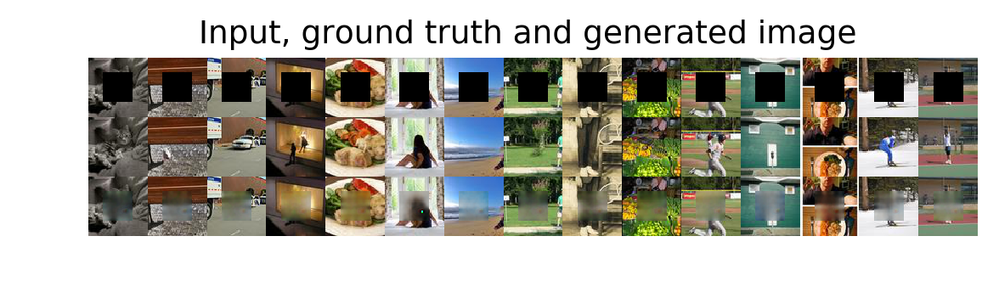

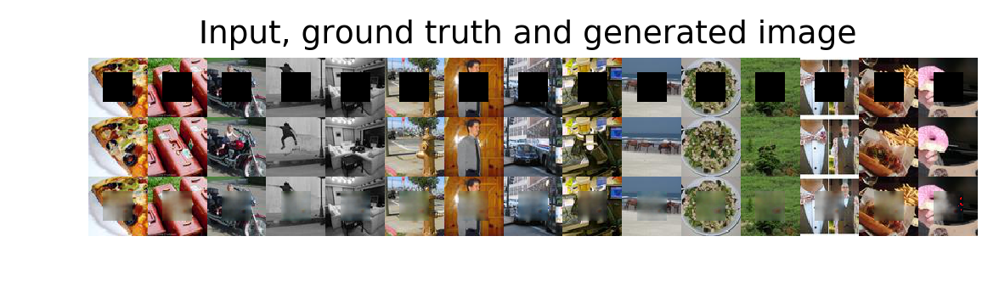

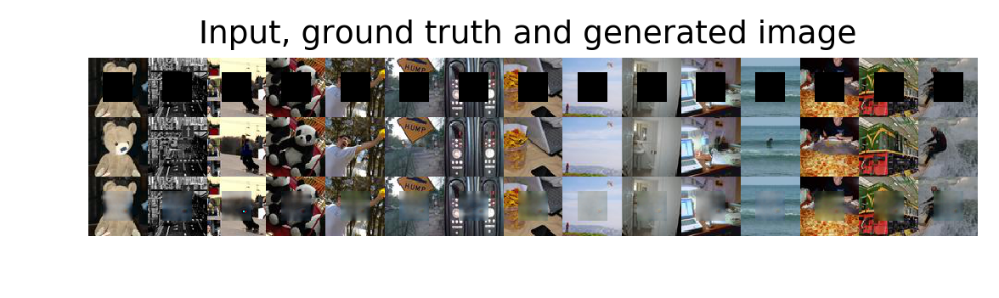

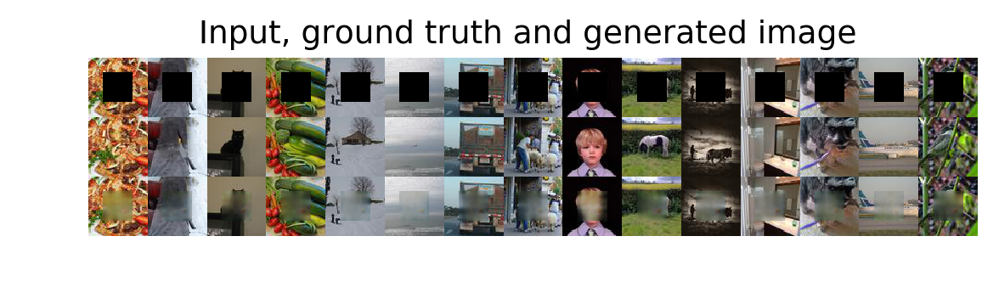

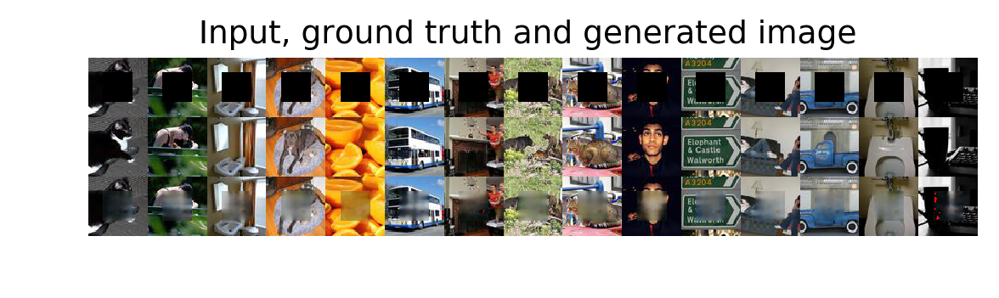

Avg cost test 0.001013, took 7.187621 s
AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


In [41]:
get_test_error(model, train_iter, plot_results=True, max_batch = 5)

AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


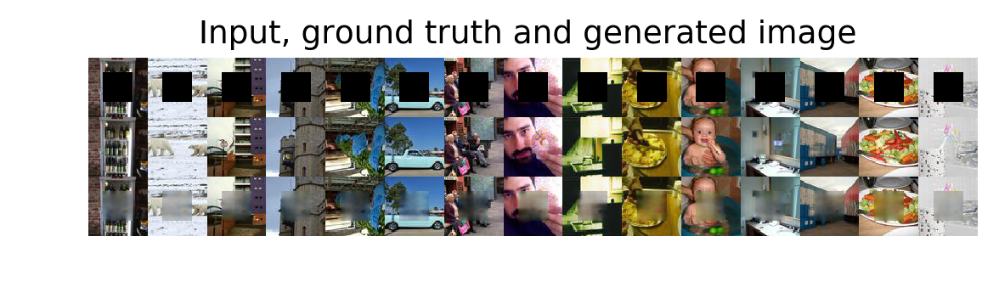

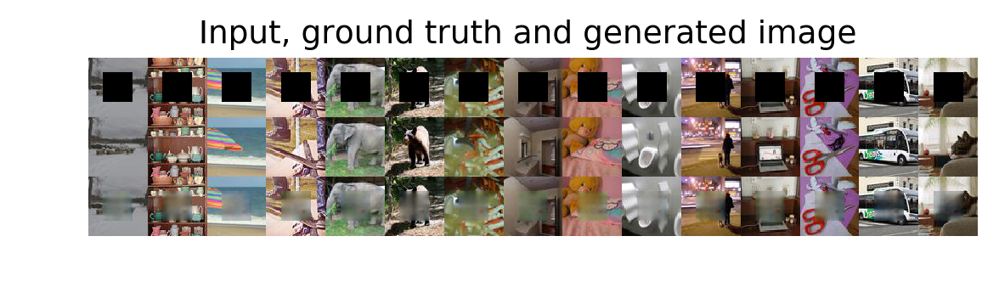

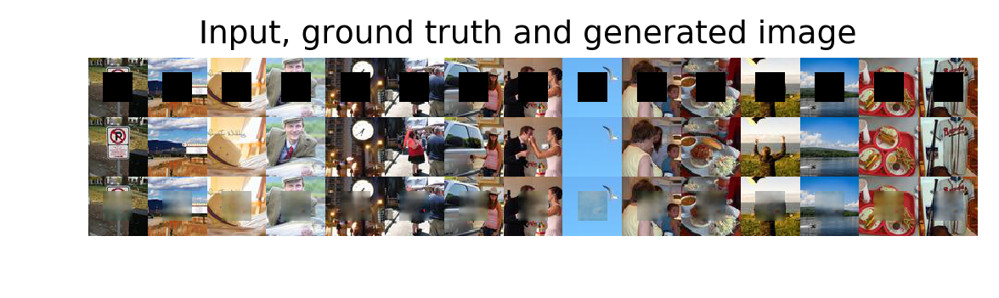

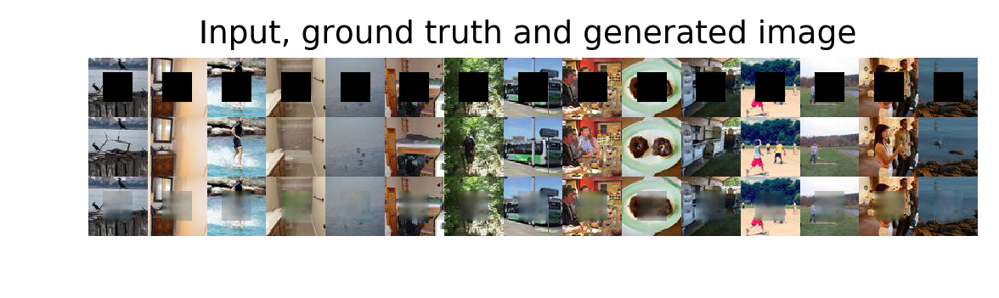

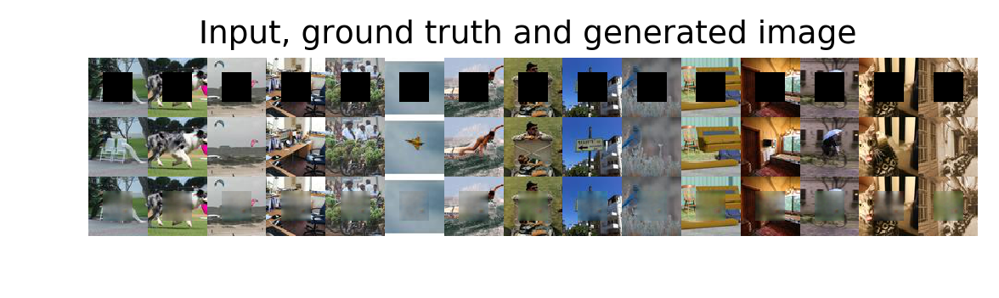

Avg cost test 0.002268, took 6.910777 s
AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


In [42]:
get_test_error(model, valid_iter, plot_results=True, max_batch = 5)

## AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


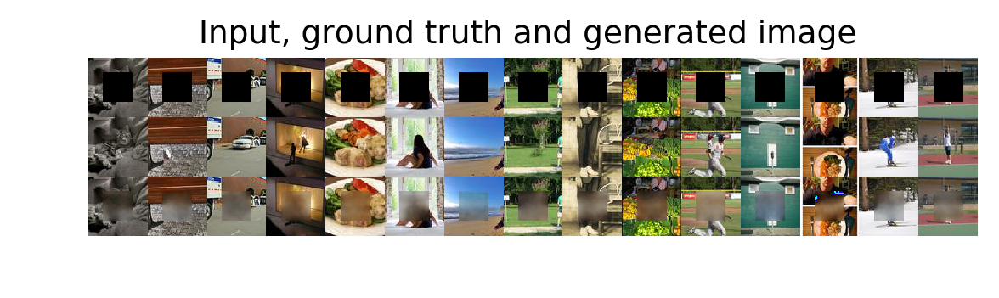

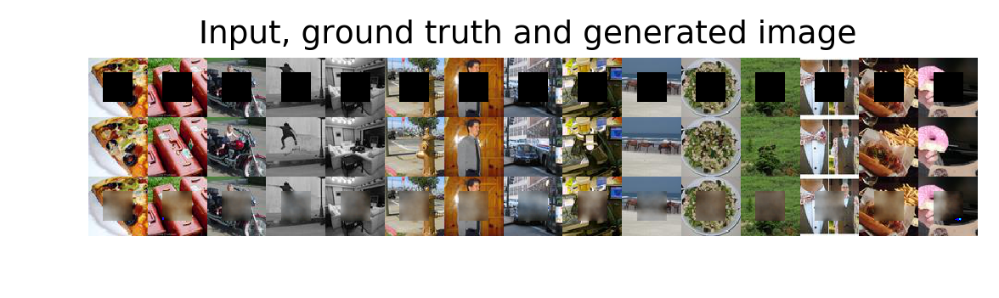

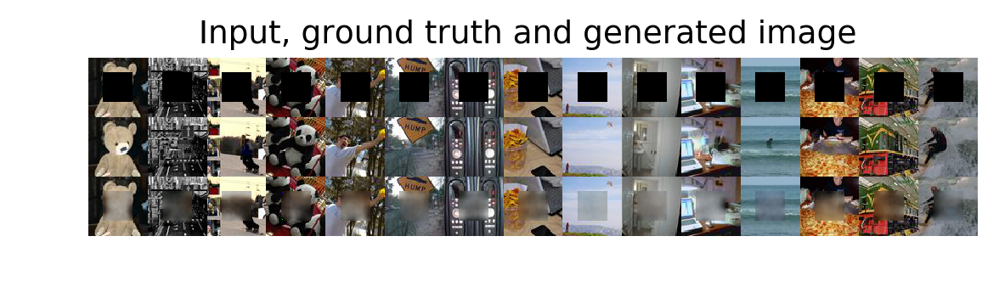

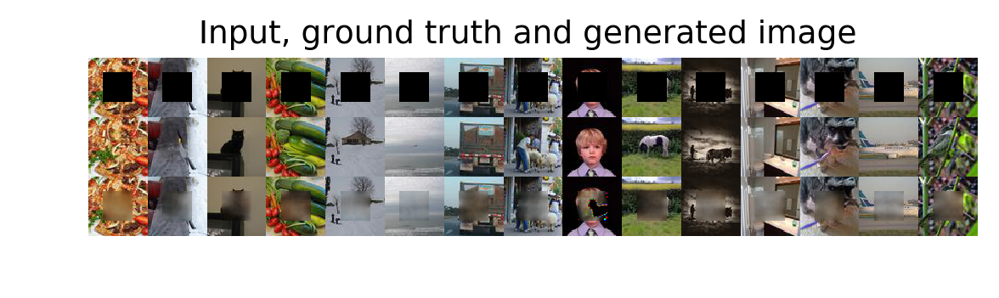

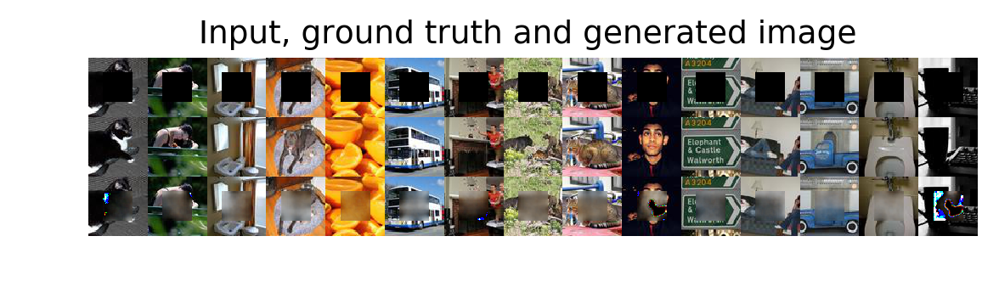

Avg cost test 0.001157, took 6.799740 s
AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


In [34]:
get_test_error(model, train_iter, plot_results=True, max_batch = 5)

AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


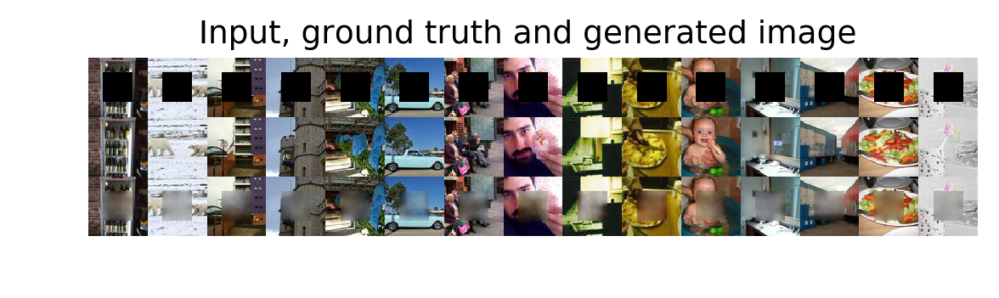

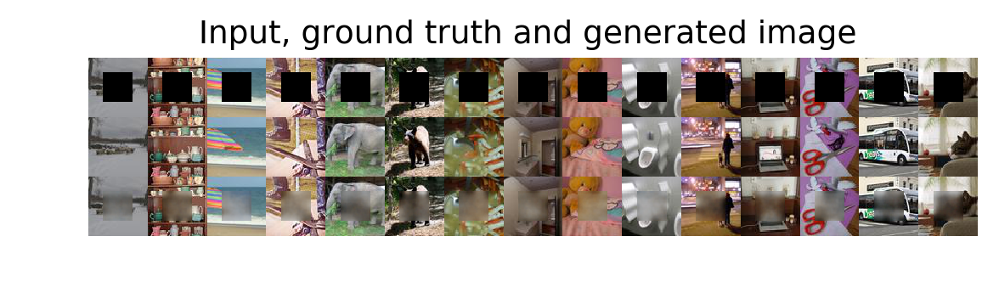

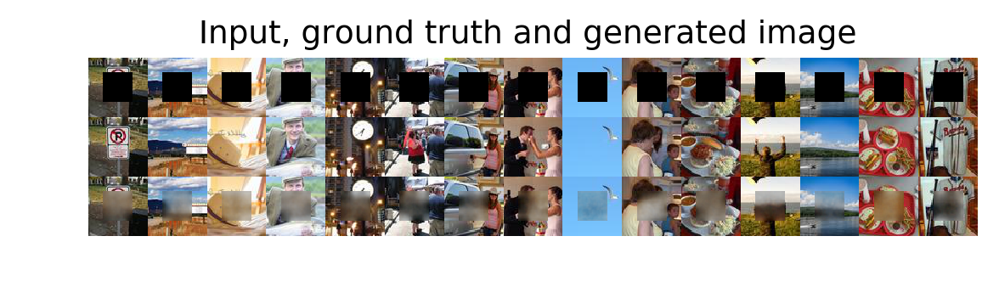

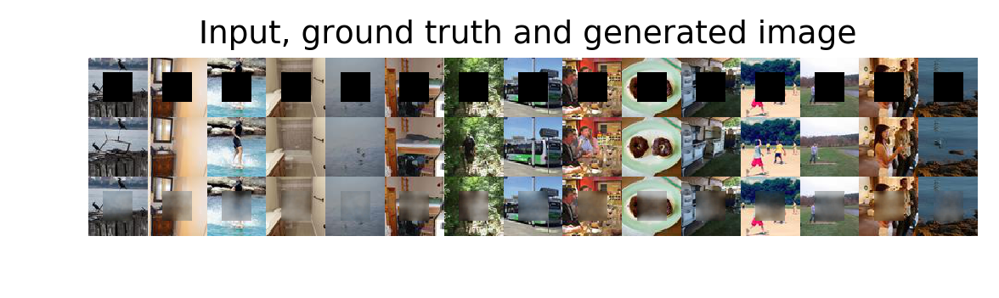

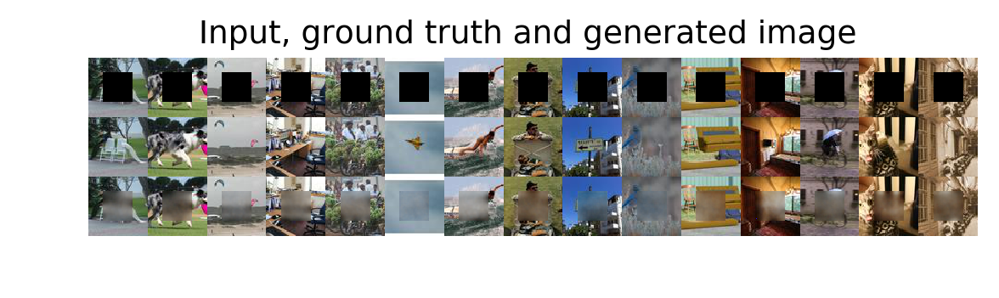

Avg cost test 0.002586, took 6.556373 s
AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=500


In [35]:
get_test_error(model, valid_iter, plot_results=True, max_batch = 5)

## AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750

AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


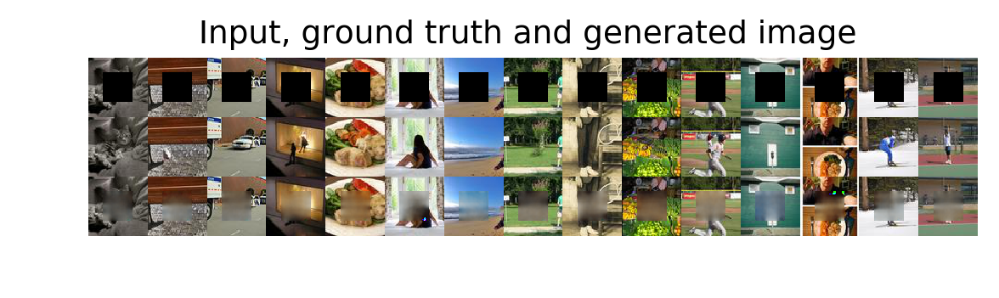

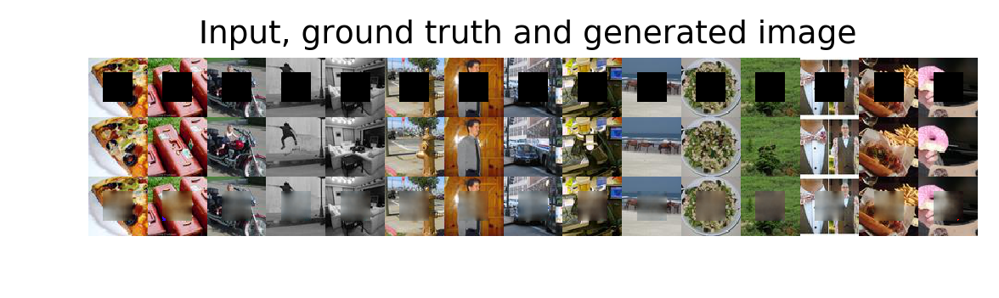

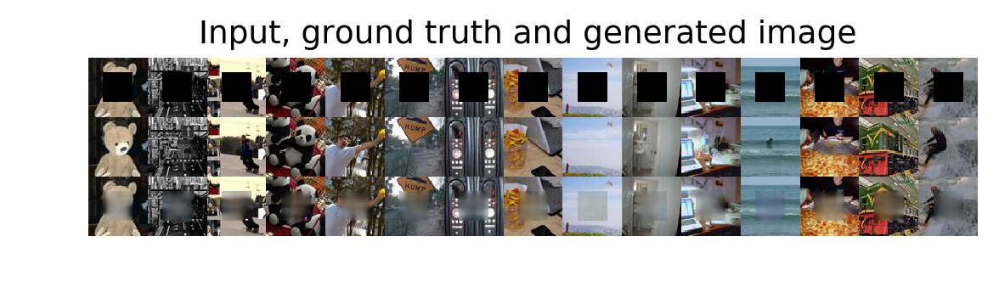

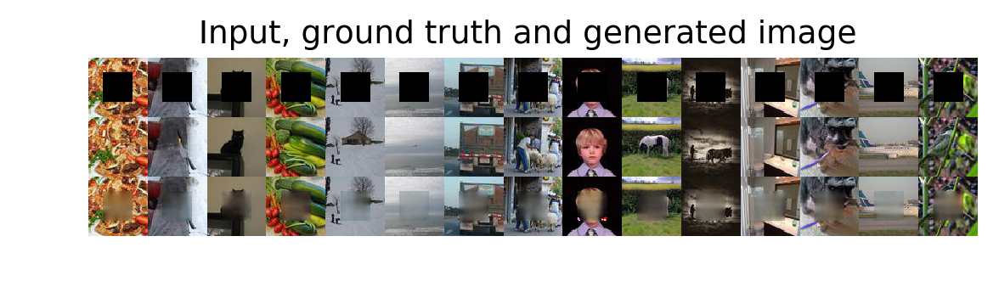

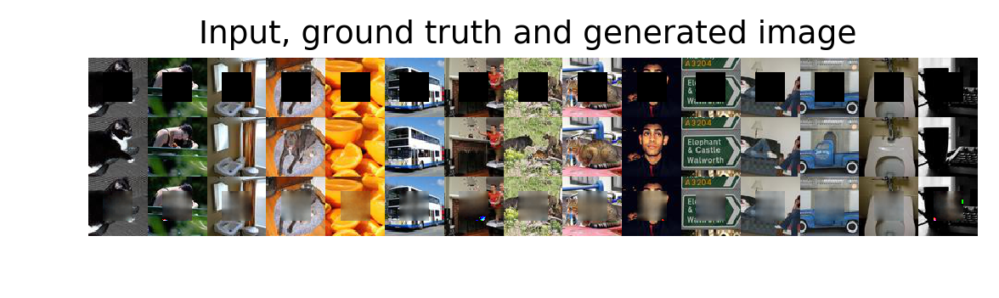

Avg cost test 0.001048, took 6.858474 s
AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


In [26]:
get_test_error(model, train_iter, plot_results=True, max_batch = 5)

AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


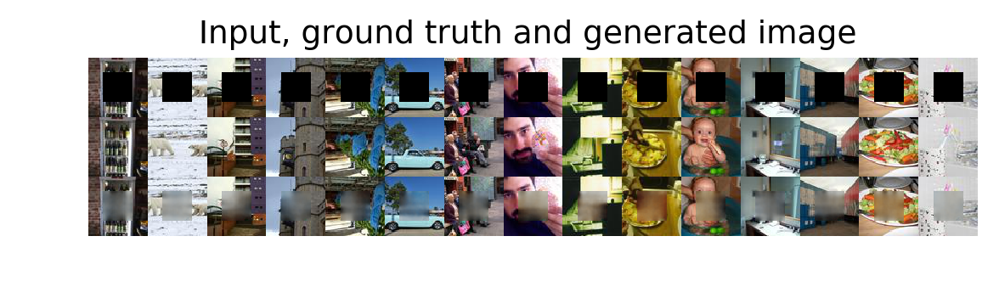

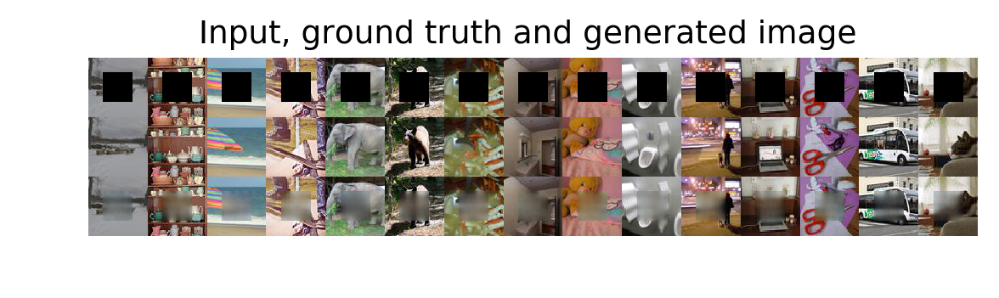

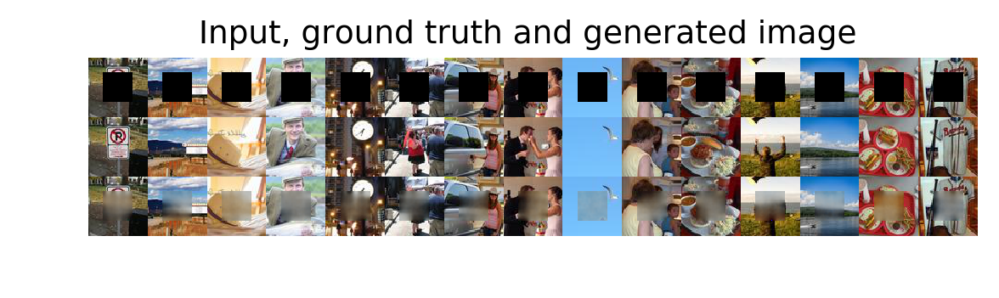

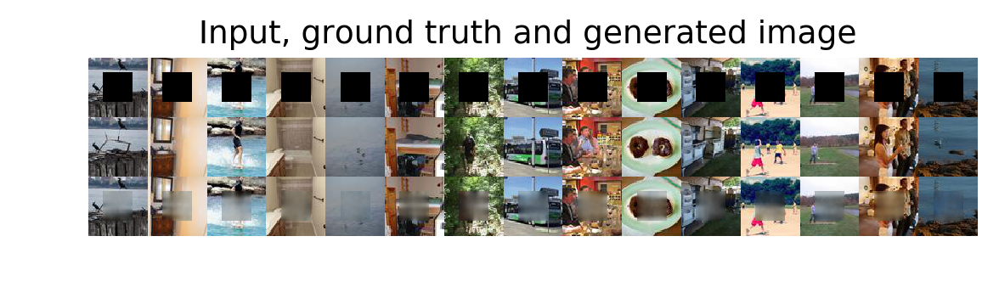

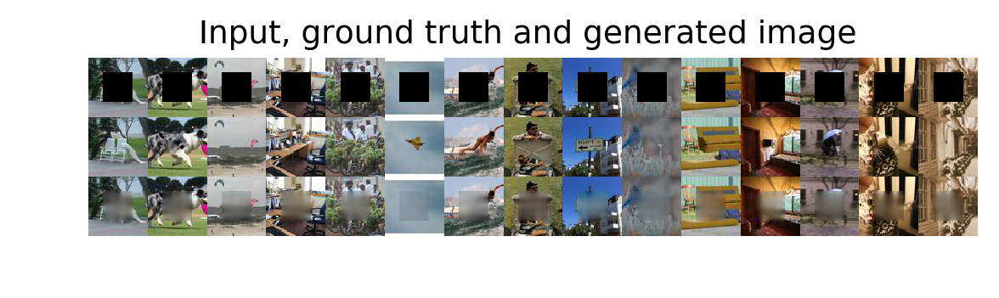

Avg cost test 0.002216, took 7.018998 s
AE_1capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


In [27]:
get_test_error(model, valid_iter, plot_results=True, max_batch = 5)

## AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750

AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


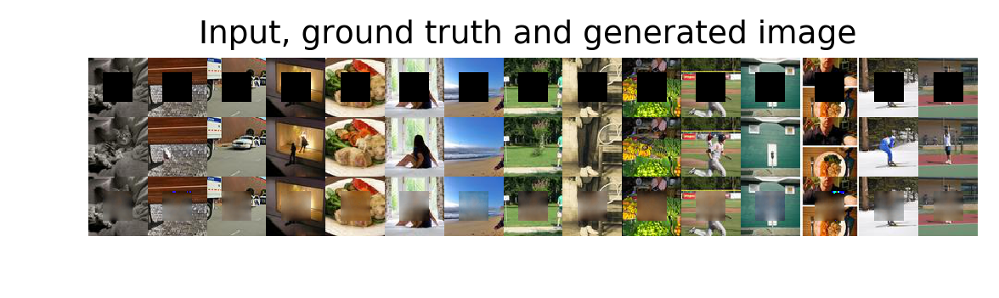

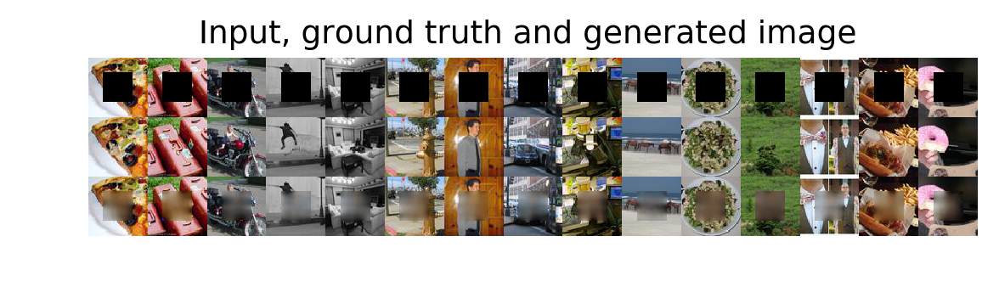

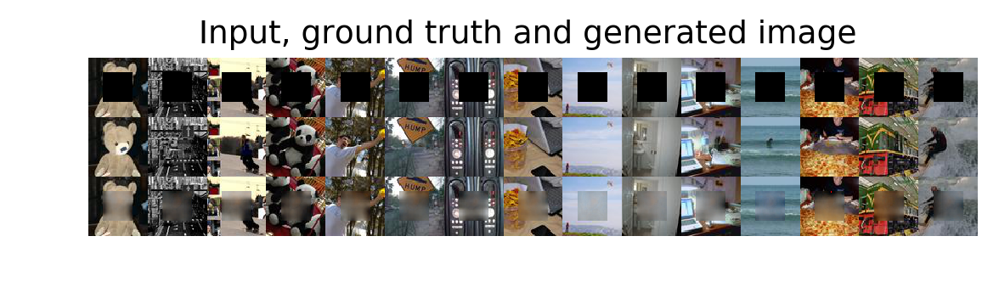

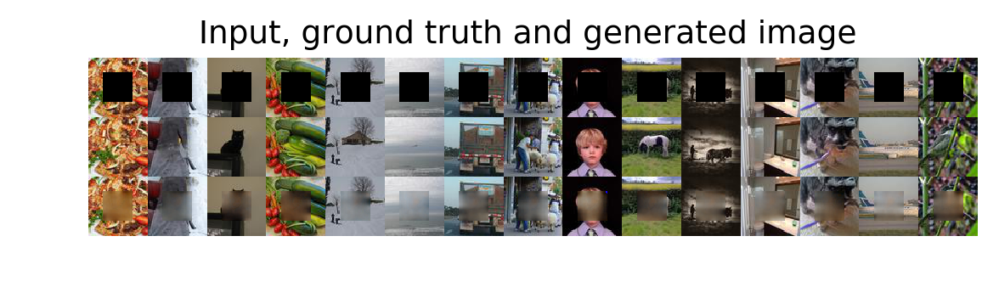

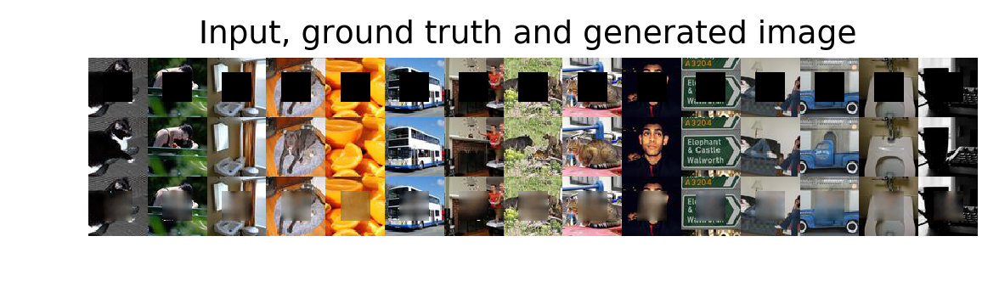

Avg cost test 0.001127, took 7.216162 s
AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


In [16]:
get_test_error(model, train_iter, plot_results=True, max_batch = 5)

AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


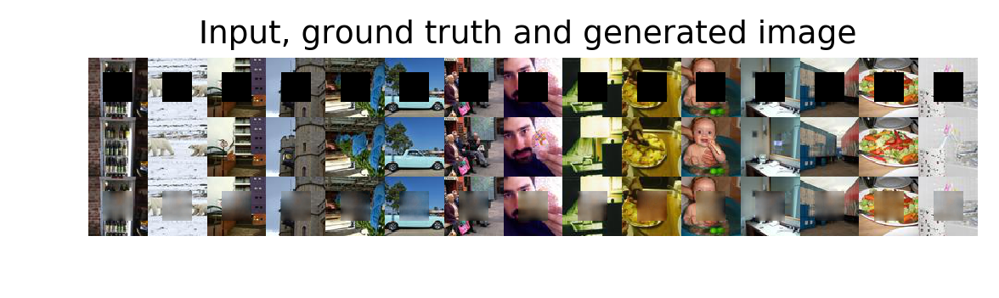

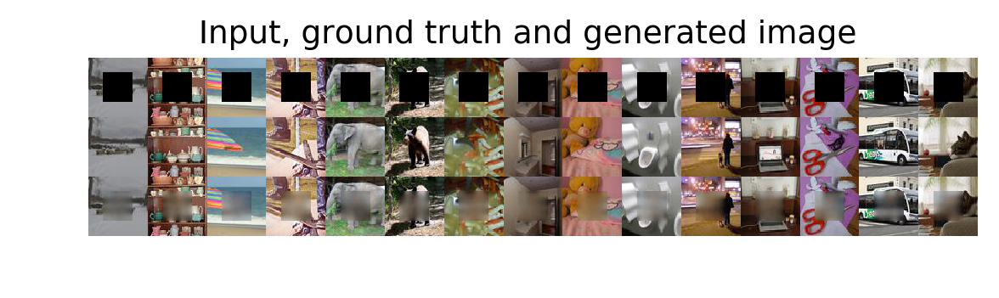

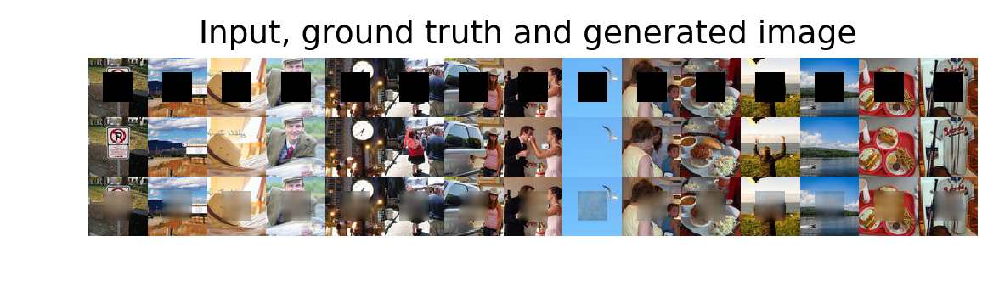

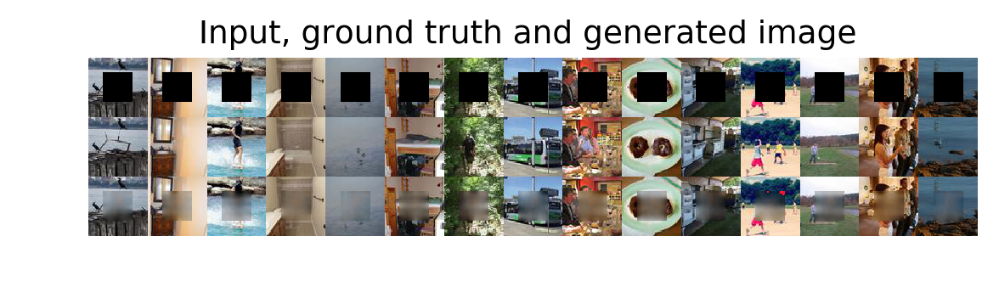

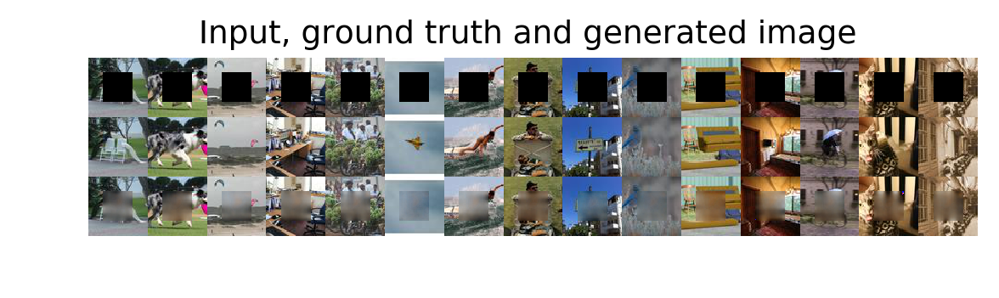

Avg cost test 0.002321, took 19.109592 s
AE_5capsreal+_lr=0.01_wd=0_bs=512_conv=[2, 2]_nfilt=32_code=750


In [19]:
get_test_error(model, valid_iter, plot_results=True, max_batch = 5)